In [1]:
import pandas as pd
import sys
from datetime import date, datetime
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
bremen_trips = pd.read_csv("../data/processed/bremen.csv")
bremen_trips = bremen_trips.sort_values(by=['start_time'], ascending=True)

# Feature creation

In [3]:
bremen_trips["start_time"] = pd.to_datetime(bremen_trips["start_time"])

In [4]:
for col in ['start_time']:
    bremen_trips['month'] = pd.DatetimeIndex(bremen_trips['start_time']).month
    bremen_trips['booking_date'] = bremen_trips.start_time.dt.date
    bremen_trips['weekdays'] = pd.DatetimeIndex(bremen_trips['start_time']).weekday
    bremen_trips['hour'] = pd.DatetimeIndex(bremen_trips['start_time']).hour

In [5]:
bremen_trips['booking_date'] = pd.to_datetime(bremen_trips['booking_date'])

In [6]:
display(bremen_trips.head(3),bremen_trips.tail(3))

,bike,identification,start_time,end_time,weekend,duration_sec,start_lng,start_lat,end_lng,end_lat,...,direction_degree_x,max_m/s,min_mean_m/s,max_mean_m/s,direction_degree_y,min,month,booking_date,weekdays,hour
47381,20685,12099440,2019-01-20 00:13:00,2019-01-20 00:23:00,1,600.0,8.812554,53.076481,8.804828,53.084196,...,80.0,3.1,2.1,2.6,80.0,0.0,1,2019-01-20,6,0
31405,20626,10278649,2019-01-20 00:16:00,2019-01-20 04:47:00,1,16260.0,8.884911,53.078923,8.884911,53.078923,...,80.0,3.1,2.1,2.6,80.0,0.0,1,2019-01-20,6,0
28745,20617,12099749,2019-01-20 00:40:00,2019-01-20 00:44:00,1,240.0,8.801623,53.067878,8.793217,53.064244,...,80.0,3.1,2.4,2.6,80.0,0.0,1,2019-01-20,6,0


,bike,identification,start_time,end_time,weekend,duration_sec,start_lng,start_lat,end_lng,end_lat,...,direction_degree_x,max_m/s,min_mean_m/s,max_mean_m/s,direction_degree_y,min,month,booking_date,weekdays,hour
125499,20965,26519958,2019-12-31 23:41:00,2019-12-31 23:49:00,0,480.0,8.871098,53.077498,8.872118,53.082471,...,180.0,1.5,0.0,0.8,180.0,0.0,12,2019-12-31,1,23
66914,20757,26520201,2019-12-31 23:44:00,2019-12-31 23:59:00,0,900.0,8.821334,53.081942,8.806207,53.078418,...,180.0,1.5,0.0,0.8,180.0,0.0,12,2019-12-31,1,23
65713,20751,26520148,2019-12-31 23:51:00,2019-12-31 23:57:00,0,360.0,8.815570,53.054449,8.811623,53.060347,...,190.0,2.1,0.5,1.2,190.0,0.0,12,2019-12-31,1,23


In [7]:
bremen_trips["duration_sec"].describe().astype(int)

count    132982
mean       2381
std        7579
min         120
25%         480
50%         780
75%        1320
max       86340
Name: duration_sec, dtype: int64

In [8]:
bremen_trips["duration_min"] = bremen_trips["duration_sec"]/60

# Visualization

#### 2.a Visualization of # started trips per PLZ region
#### 2.b For one moment in time, visualize the number of bikes at fixed stations meaningfully.
## 2.c) Create a heatmapbased on an interesting aspect of the data, e.g., end locations of trips shortly before the start of a major public event.
#### 2.d) Visualize  the  distribution  of  trip  lengths  per  month.  Compare  the  distributions  to  normal distributions with mean and standard deviation as calculated before(1.d))

### Interesting dates with major events

- 31.01.19 (peak Jan) -> Donnerstag: https://criticalmass.in/help/about Fahrradtour
- 27.02.19 (peak feb) -> Mittwoch: DPolG Bremen Demonstration 7000 Leute
- 10.02.19 (min feb) -> Sonntag: BuLi Bremen vs. Augsburg
- 29.03.19 (peak 1 mar) -> Freitag: nix besonderes
- 30.03.19 (peak 2 mar) -> Samstag: BuLi Bremen vs. mainz
- 24.04.19 (peak 1 apr) -> Mittwoch: DFB pokal Bremen vs. Bayern (in Berlin)
- 30.04.19 (peak 2 apr) -> Dienstag: (Tag darauf ist Feiertag)
- 05.05.19 (min may) -> Sonntag: BuLi Bremen vs. Dortmund + kalt
- 18.05.19 (peak may) -> Samstag:  BuLi Bremen vs. RB Leipzig + "Bremen räumt auf Festival" am Marktplatz
- 08.06.19 (min jun) -> Samstag (Tage darauf sind Feiertage) "megamarsch" 50km Wanderung + "La Strada" festival pre party?
- 14.06.19 (peak jun) -> Freitag Beginn "La Strada Festival", Tag darauf Open Campus der universität
- 31.08.19 (peak aug) -> Samstag: Christopher Street Day
- 18.08.19 (min aug) -> Sonntag:  Überseetörn Festival
- 20.09.19 (peak 1 sep)  -> Freitag "Fridays for future" Bahnhofsvorplatz 30.000 Menschen (eine der größten Demos der Stadtgeschichte)
- 21.09.19 (peak 2 sep) -> Samstag "Maritime Woche Bremen"
- 29.09.19 (min sep) -> Sonntag: nix
- 30.10.19 (peak oct) -> Mittwoch: (Tag darauf ist Feiertag) + BuLi bremen vs heidenheim
- 20.10.19 (min oct) -> Sonntag: nur bremer freimarkt
- 26.11.19 (peak 1 nov)  -> Dienstag: nix
- 29.11.19 (peak 2 nov) -> Freitag: "Fridays for future"
- 17.12.19 (peak dec) -> Dienstag: BuLi Bremen vs. Mainz + "Dein Festmahl" Event Messehalle
- 24-25.12.19 (min dec) -> Di, Mi (Weihnachten + Feiertage)

### Imports and defined functions

In [9]:
import folium
from folium.plugins import HeatMapWithTime

In [10]:
#base map with center Bremen
def generateBaseMap(default_location=[53.073635,8.806422], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map


In [11]:
#dynamische heatmap mit Startpunkten der trips
def generateHeatWithTimeStart(df_list, loc=[53.075890,8.807021]):
    #Stundenliste erstellen
    df_hour_list = []
    for hour in df_list.hour.sort_values().unique():
        df_hour_list.append(df_list.loc[df_list.hour == hour, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())
    #base_map erstellen
    global heat_start
    heat_start = generateBaseMap(default_location=loc,default_zoom_start=12)
    #heatmap features hinzufügen
    HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(heat_start)
    #markers wichtigster Orte:
    folium.Marker([53.108356, 8.851881], popup='University').add_to(heat_start)
    folium.Marker([53.084161, 8.813285], popup='main station').add_to(heat_start)
    folium.Marker([53.075833, 8.806998], popup='Marktplatz').add_to(heat_start)

In [12]:
#dynamische heatmap mit ENDpunkten der trips
def generateHeatWithTimeEnd(df_list, loc=[53.075890,8.807021]):
    #Stundenliste erstellen
    df_hour_list = []
    for hour in df_list.hour.sort_values().unique():
        df_hour_list.append(df_list.loc[df_list.hour == hour, ['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist())
    #base_map erstellen
    global heat_end
    heat_end = generateBaseMap(default_location=loc,default_zoom_start=12)
    #heatmap features hinzufügen
    HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(heat_end)
    #markers wichtigster Orte:
    folium.Marker([53.108356, 8.851881], popup='University').add_to(heat_end)
    folium.Marker([53.084161, 8.813285], popup='main station').add_to(heat_end)
    folium.Marker([53.075833, 8.806998], popup='Marktplatz').add_to(heat_end)

### Example base map of Bremen

In [13]:
base_map = generateBaseMap()
base_map

### Heatmap of trip starts over whole period (2019)

In [14]:
from folium.plugins import HeatMap
df_copy = bremen_trips
#df_copy['count'] = 1
base_map = generateBaseMap()
HeatMap(data=df_copy[['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)

base_map.save('../reports/figures/hm_trip_starts_2019.html')
base_map

### Heatmap of trip ends over whole period (2019)

In [15]:
base_map = generateBaseMap()
HeatMap(data=df_copy[['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map.save('../reports/figures/hm_trip_ends_2019.html')
base_map

### dynamic Heatmap - 24 hours (2019)

In [16]:
df_hour_list = []
for hour in df_copy.hour.sort_values().unique():
    df_hour_list.append(df_copy.loc[df_copy.hour == hour, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())

In [17]:
base_map = generateBaseMap(default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map.save('../reports/figures/hm_24_hours_2019.html')
base_map

### dynamic Heatmap - weekdays (2019)

In [18]:
df_weekdays_list = []
for weekdays in df_copy.weekdays.sort_values().unique():
    df_weekdays_list.append(df_copy.loc[df_copy.weekdays == weekdays, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())

In [19]:
base_map = generateBaseMap(default_zoom_start=12)
HeatMapWithTime(df_weekdays_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map.save('../reports/figures/hm_weekdays_2019.html')
base_map

### dynamic Heatmap - months (2019)

In [20]:
df_hour_list = []
for month in df_copy.month.sort_values().unique():
    df_hour_list.append(df_copy.loc[df_copy.month == month, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())

In [21]:

base_map = generateBaseMap(default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map.save('../reports/figures/hm_months_2019.html')
base_map

### 2.c Create a heatmap based on an interesting aspect of the data, e.g., end locations of trips shortly before the start of a major public event.

# January

Text(0.5, 1.0, 'January')

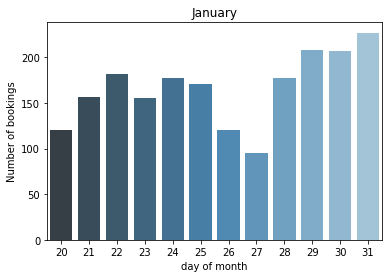

In [22]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 1].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('January')

### 31.01 (230) peak in January on Thursday: https://criticalmass.in/help/about Fahrradtour

No major events took place from the 20th until the 31st of January. The highest amount of bookings were on January 31st. The critical mass bycycle tour took place on that thursday, though no valid information about it's amount of participants is available.

#### No Findings

In [23]:
# Peak 31.01 230 bookings
df_3101 = bremen_trips.loc[bremen_trips.booking_date == '2019-01-31']
len(df_3101)

227

In [24]:
generateHeatWithTimeStart(df_3101)
#folium.Marker([51.5079, 0.0877], popup='Event').add_to(map_hooray)
heat_start

In [25]:
generateHeatWithTimeEnd(df_3101)
heat_end

# February

Text(0.5, 1.0, 'Februar')

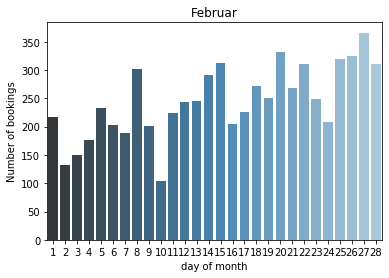

In [26]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 2].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('Februar')

### 27.02.19 (390) Peak in February on Wednesday: DPolG Bremen Demonstration 7000+ People
In Februrary, the highest amount of bike trips accounted for were on a Wednesday, the 27th. On that day a major demonstration consisting of 7000+ people took place around the Marktplatz / Rathaus area within the city center. 
#### Findings:
- We can see some end_trips close to that area around 10-12 am in our heatmap.

In [27]:
# Peak 27.02 230 bookings
df_2702 = bremen_trips.loc[bremen_trips.booking_date == '2019-02-27']
len(df_2702)

366

In [28]:
generateHeatWithTimeStart(df_2702)
#folium.Marker([51.5079, 0.0877], popup='Event').add_to(map_hooray)
heat_start

In [29]:
generateHeatWithTimeEnd(df_2702)
heat_end

# March

Text(0.5, 1.0, 'march')

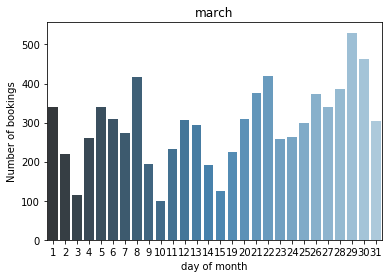

In [30]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 3].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('march')

### 30.03.19 (495) Saturday, football match @ Weser stadium
The highest amount of bookings were on march 29th (Friday) and 30th (Saturday). No major public events took place on these dates, excpect for a football match on Saturday - Bremen vs. Mainz - at the Weser stadium (53.066620, 8.837573). Ideally, we'd expect to see trip_ends near Weser stadium before 15:30 pm, as well as trip_starts shortly after the end of the match near Weser stadium around 17-18pm.

#### Findings:
- We can see a couple of trip_starts in surrunding areas of Weser stadium starting 15 pm, assumeably people who live close by.
- After 17 pm we can see lots of trip_starts in the areas around Weser stadium, the people start heading home. After 19 pm the bike bookings seem to be normal again.
- From 13 pm until 15 pm we can clearly see a peak in trip_ends around Weser stadium, which suggests some people took a NextBike to see the match.

In [31]:
df_3003 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-03-30"]
len(df_3003)

464

In [32]:
#Überschrift einfügen!
generateHeatWithTimeStart(df_3003)
folium.Marker([53.066620, 8.837573], popup='Weser stadium').add_to(heat_start)
heat_start

In [33]:
generateHeatWithTimeEnd(df_3003)
folium.Marker([53.066620, 8.837573], popup='Weser stadium').add_to(heat_end)
heat_end

### 06.03.19 (Major Event - 326) The Dutch royals visiting Bremen
https://www.weser-kurier.de/bremen/bremen-stadt_artikel,-niederlande-setzen-auf-zusammenarbeit-_arid,1812150.html
https://www.weser-kurier.de/bremen_artikel,-diese-orte-besucht-das-niederlaendische-koenigspaar-in-bremen-_arid,1811403.html
    
The Netherlands would like to further consolidate its relations with Bremen. Over 340 companies from the Hanseatic city have trade relations with the Netherlands. That means, they either have branches, foreign representatives or production facilities in the country or they import or export goods. Accompanied by a business delegation, Queen Máxima and King Willem-Alexander visited the state and companies in the fields of space travel, wind energy and polar and marine research in Bremen and Bremerhaven on Wednesday, the 6th of march 2019. Representatives of the commissions reached agreements for closer economic cooperation.

Rough timeline:
- Station 1 @ 10:50 Bremen airport @ Airbus Defence & Space Bremen 53.052908, 8.794159
- Station 2 @ 12:00 Bremen Rathhaus Kings's speech 53.076209, 8.807911
- Station 3 @ 14:00 via Marktplatz to Bremer Stadtmusikanten 53.076435, 8.807514
- Station 4 @ 15:00 Handelskammer Bremen 53.075745, 8.806354
- Station 4 @ 18:00 Bremerhaven @ Fraunhofer-Institut für Windenergiesysteme 53.519505, 8.571213
- Station 6 @ 19:00 Bremerhaven @ Alfred-Wegener-Institut 53.533459, 8.580462
- ROADBLOCKS from 11:00 until 15:00 @ streets around Marktplatz (Stintbrücke, Langenstraße, Hakenstraße and Am Markt) 

#### Findings:
- We can see less traffic from 11:00 am until around 15:00 pm around the city center (Stations 1 - 4), which might be due to the road blocks around Bremens Marktplatz.



In [34]:
#06.03 Mittwoch, Besuch der Königsfamilie Niederlande #356 booking_trips
df_0603 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-03-06"]
len(df_0603)

309

In [35]:
generateHeatWithTimeEnd(df_0603)
folium.Marker([53.052908, 8.794159], popup='1: Airbus').add_to(heat_end)
folium.Marker([53.076209, 8.807911], popup='2: Rathaus').add_to(heat_end)
folium.Marker([53.076435, 8.807514], popup='3: Stadtmusikanten').add_to(heat_end)
folium.Marker([53.075745, 8.806354], popup='4: Handelskammer').add_to(heat_end)
folium.Marker([53.519505, 8.571213], popup='5: Hafen/Fraunhofer').add_to(heat_end)
folium.Marker([53.533459, 8.580462], popup='6: Hafen/Alfred').add_to(heat_end)
heat_end

# April

Text(0.5, 1.0, 'April')

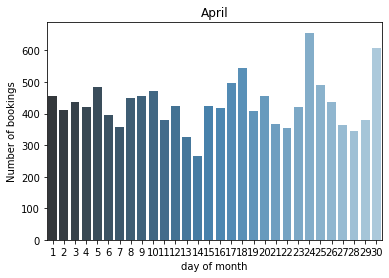

In [36]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 4].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('April')

### 24.04.19 (first peak) 
With over 700 bookings, it seems there is an overall upwards trend in bike bookings. the 24th of April is a Wednesday with no major events. There may have been public viewing events because of the DFB Pokalspiel Werder vs. Bayern. Since the match took place in Berlin, we gain insights from that event.

### 30.04.19 (second peak) 
With almost 700 bookings the 30th of April marked another day with extraordinary amount of bookings. Since the day after is a holidy, we assume this Tuesday peak as a natural consequence of higher demand due to more free time. Other than that, no major events took place.

# May

Text(0.5, 1.0, 'May')

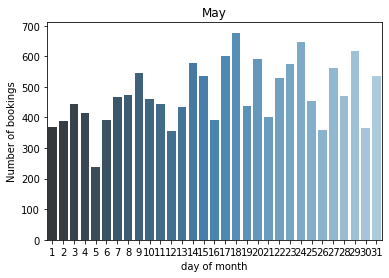

In [37]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 5].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('May')

### 05.05.19 minimum
It's a cold sunday, which does not seem like there is high demand for NextBikes.
### 18.05.19 (peak of) Football game & "Bremen räumt auf Festival" @ Marktplatz
We excpect end_trips shortly before the start of the game near Weser stadium, as well as start_trips shortly after the game. We also excpect an increase in end_trips near Marktplatz due to "Bremen räumt auf Festival".

#### Findings:
- We can see many trip_ends starting from 10 am until 14 pm about at marktplatz.
- We can see many trip ends near Weser stadium starting from 12 am until 14 pm.

In [38]:
#06.03 Mittwoch, Besuch der Königsfamilie Niederlande #356 booking_trips
df_1805 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-05-18"]
len(df_1805)

677

In [39]:
generateHeatWithTimeEnd(df_1805)
folium.Marker([53.066620, 8.837573], popup='Weser stadium').add_to(heat_end)
heat_end

# June

Text(0.5, 1.0, 'Juni')

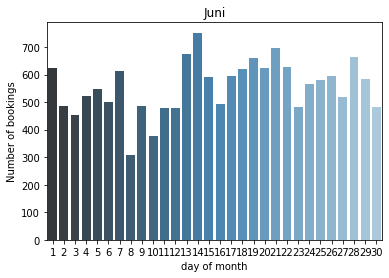

In [40]:
#Distribution Number of bookings per month
# bremen_trips.start_time.dt.day.value_counts()
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 6].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('Juni')

### 15.06 (second peak of 676) on Saturday: La Strada festival @ Schildstraße, OPEN CAMPUS @ university, festival @ Strasse Am Wall 53.079705, 8.806789 etc.
The international street artists' festival "La Strada" (53.072559, 8.822193), the Wallfest (53.079705, 8.806789) with a "folding bike and folding bicycle race" and a "leisure mile" in the Lloyd Passage will lure the flaneurs, visionaries and shoppers to the city of Bremen on Friday, Saturday and Sunday, 15-16 June. In addition, the retailers in the city centre, in the quarter and on the Wall will be opening their doors for Sunday's shopping pleasure from 1 to 6 pm. And the Kajenmarkt an der Schlachte also has a double package on offer, so it will be open on Saturdays and Sundays from 11 a.m. to 6 p.m.

The Open Campus Uni Bremen attracted about 20000 visitors to the university on Saturday. The concert started at 7 pm. From 18 o'clock several end-trips on the university campus can be seen in the heat map.

We excpect trip_ends shortly before the begin of the "Open Campus Concert" at the University aroudn 18pm.
We also expect trip_ends near the "Wall-Fest", as well as near the "La-Strada" festivals


#### Findings:
- We can clearly see more traffic in all areas around the three mentioned festivals within the overall day heatmap.
- When adding the time dimension, we can see trip_end peaks around festival 1 & 2 starting from 14 pm.
- We can clearly see bike traffic to Festival 3 @ university starting from 18 pm, which makes sense, since the concerts starts at 19 pm.


In [41]:
df_1506 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-06-15"]
len(df_1506)

590

#### End trips

In [42]:
#heatmap of full day with locations
base_map = generateBaseMap(default_location=[53.108610,8.853722])
HeatMap(data=df_1506[['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
folium.Marker([53.072559, 8.822193], popup='Festival 1: La Strada').add_to(base_map)
folium.Marker([53.079705, 8.806789], popup='Festival 2: Wallfest').add_to(base_map)
folium.Marker([53.108356, 8.851881], popup='Festival 3: open Campus').add_to(base_map)
base_map

In [43]:
generateHeatWithTimeEnd(df_1506)
folium.Marker([53.072559, 8.822193], popup='Festival 1: La Strada').add_to(heat_end)
folium.Marker([53.079705, 8.806789], popup='Festival 2: Wallfest').add_to(heat_end)
heat_end

# August

Text(0.5, 1.0, 'August')

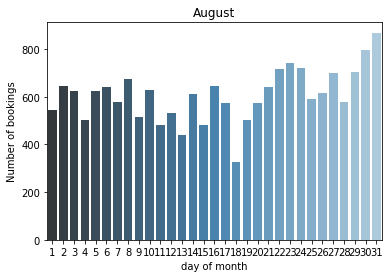

In [44]:
#Distribution Number of bookings per month
# bremen_trips.start_time.dt.day.value_counts()
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 8].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('August')

### 31.08.19 (peak 1016): Major event Christopher Street Day
On Saturday the 31st of August, Christopher Street Day took place in Bremen. We expect to see an increase in trip_ends in the areas near Marktplatz and HBF.
- 12:00: Start of the demonstration at AltenWall
- 14:00: Intermediate rally at the market place
- 15:30: Final rally at the Theater am Goetheplatz

#### Findings:
- We can see peaks in trips ends at Marktplatz at 10 am as well as 12 am. 
- In general the area of the CSD is higly popular in trip ends.
- Surprisingly, even after 21 pm there are still a lot of bike trips taken, a significant amount of them to the main train station.

In [45]:
df_3108 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-08-31"]
len(df_3108)

869

In [46]:
generateHeatWithTimeEnd(df_3108)
heat_end

# September

Text(0.5, 1.0, 'september')

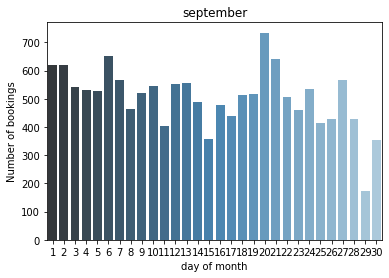

In [47]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 9].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('september')

### 20.09.19 (peak 883): Fridays for future 
The "Fridays for future" @ Bahnhofsvorplatz took place. With over 30.000 people, it is considered one of the biggest public gatherings of Bremens history. We excpect an increase in trip_ends near HBF Bremen, where the event took place. https://www.butenunbinnen.de/videos/globale-fridays-for-future-demo-100.html

#### Findings:
- We can see peaks in end_trips @ HBF Bremen at 8, 9 and 12 am.
- In general, there seem to be more trips to the city center near HBF than usual.

In [48]:
df_2009 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-09-20"]
len(df_2009)

734

In [49]:
generateHeatWithTimeEnd(df_2009)
heat_end

# October

Text(0.5, 1.0, 'October')

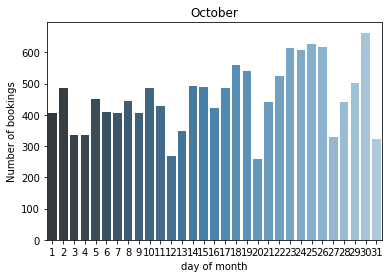

In [50]:
#Distribution Number of bookings per month
# bremen_trips.start_time.dt.day.value_counts()
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 10].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('October')

### 30.10.19 (peak oct) 
On October the 30th no major public events took place. The day after, a Thursday, is also a holiday. It seems like the demand for bikes rose because people had free time, which als occured on April, the 30th.
### 20.10.19 (min oct) 
October the 20th had the minimum of bookings of the whole month. Since it was a Sunday with no major events, low number of bookings is to be excpected. There seems to be a pattern, since Sundays without major events build up most monthly booking minima.

# November

Text(0.5, 1.0, 'November')

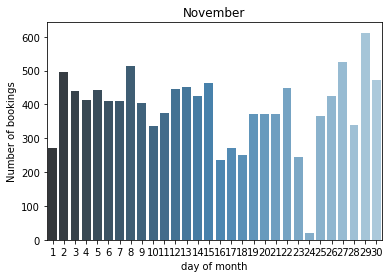

In [51]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 11].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('November')

### 26.11.19 (first peak)
No Major public events occured on this Tuesday, therefore further analysis does not make sense.
### 29.11.19 (second peak)
On this Friday, another "Fridays for future" event took place. Since it is based at HBF Bremen, we expect a peak in trip_ends around HBF during 10-12 am. Because we already analysized the huge "Fridays for future" event on the 20th of Septmeber, we will not further analyise this date.

# December

Text(0.5, 1.0, 'December')

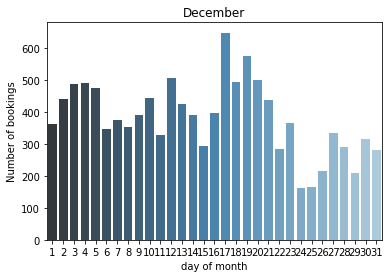

In [52]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 12].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('December')

### 17.12.19 (peak ) 
On the 17th of December, an important football match took place at Weser stadium. Bremen vs Maniz. Additionally the "Dein Festmahl" Event took place @ Messehalle Bremen. We expect a peak in trip ends shortly before the start of the football match. Since we already analysized such an event at 30th of March as well as 5th of May, we will not go into further analysis.

### 24-25.12.19 (minimum) 
Unsurprisingly, the number of bookings decreases during Christmas holidays from the 24th until the 27th. This time of the year is usually spent with the familiy at home, as businesses are closed, less people use their bikes to commute. 

## 2.d Visualize the distribution of trip lengths per month. Compare the distributions to normal distributions with mean and standard deviation as calculated before (1.d))